# Finding text using edge detection


The purpose of this assignment is to use computer vision to extract specific features from images. In particular, we're going to see if we can find text. We are not interested in finding whole words right now; we'll look at how to find whole words in a coming class. For now, we only want to find language-like objects, such as letters and punctuation.


Download and save the image at the link below:

https://upload.wikimedia.org/wikipedia/commons/f/f4/%22We_Hold_These_Truths%22_at_Jefferson_Memorial_IMG_4729.JPG


Using the skills you have learned up to now, do the following tasks: <br>
1. Draw a green rectangular box to show a region of interest (ROI) around the main body of text in the middle of the image. Save this as image_with_ROI.jpg.
2. Crop the original image to create a new image containing only the ROI in the rectangle. Save this as image_cropped.jpg.
3. Using this cropped image, use Canny edge detection to 'find' every letter in the image
4. Draw a green contour around each letter in the cropped image. Save this as image_letters.jpg


__TIPS__

Remember all of the skills you've learned so far and think about how they might be useful
This means: colour models; cropping; masking; simple and adaptive thresholds; binerization; mean, median, and Gaussian blur.
Experiment with different approaches until you are able to find as many of the letters and punctuation as possible with the least amount of noise. You might not be able to remove all artifacts - that's okay!


__Bonus challenges__

If you want to push yourself, try to write a script which runs from the command line and which takes any similar input (an image containing text) and produce a similar output (a new image with contours drawn around every letter).


__General instructions__

For this exercise, you can upload either a standalone script OR a Jupyter Notebook
Save your script as edge_detection.py OR edge_detection.ipynb
If you have external dependencies, you must include a requirements.txt
You can either upload the script here or push to GitHub and include a link - or both!
Your code should be clearly documented in a way that allows others to easily follow along
Similarly, remember to use descriptive variable names! A name like cropped is more readable than crp.
The filenames of the saved images should clearly relate to the original image


__Purpose__

This assignment is designed to test that you have a understanding of:

- how to use a variety of image processing steps;
- how to perform edge detection;
- how to combine these skills in order to find specific features in an image

__Dependencies__

In [2]:
import os
import sys
sys.path.append(os.path.join(".."))
import cv2
import numpy as np
from utils.imutils import jimshow
from utils.imutils import jimshow_channel
import matplotlib.pyplot as plt

__Load image__

In [3]:
fname = os.path.join("..", "data", "jefferson_memorial.jpeg")

In [4]:
image = cv2.imread(fname)

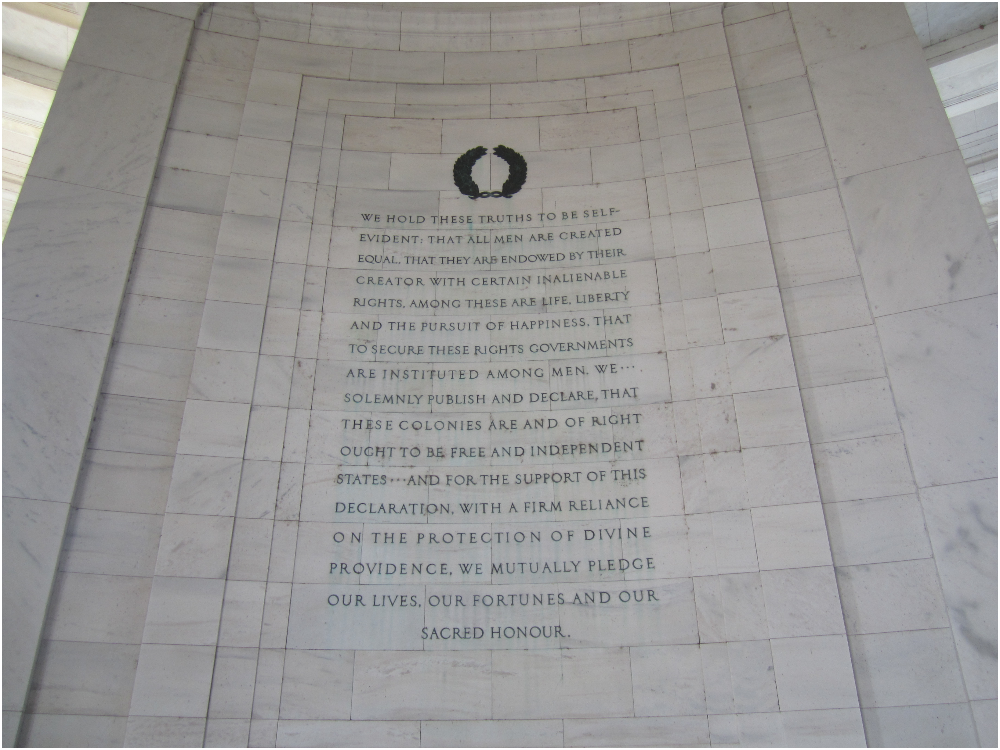

In [5]:
jimshow(image)

__Draw rectangular box__

In [6]:
image.shape

(3240, 4320, 3)

In [7]:
image_ROI = cv2.rectangle(image.copy(), (1400,880), (2900,2800), (0, 255, 0), 2)

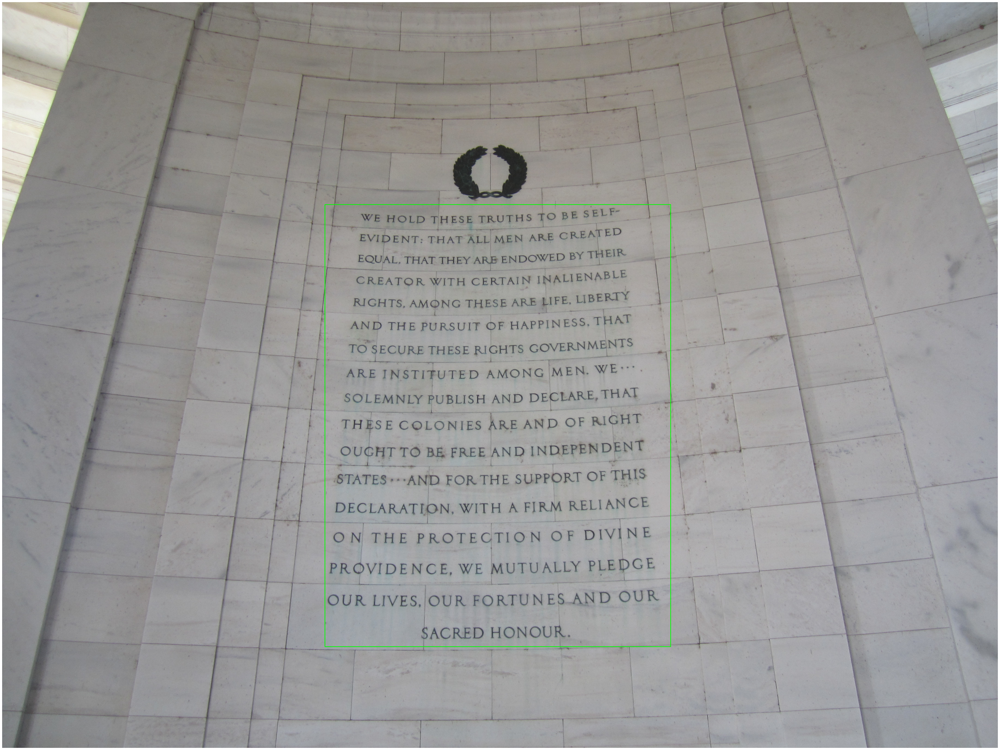

In [8]:
jimshow(image_ROI)

In [156]:
cv2.imwrite("image_ROI.jpg", image_ROI)

True

__Draw ROI on image__

In [16]:
ROI_image = cv2.rectangle(image.copy(), (1400,880), (2900,2800), (0, 255, 0), (2))

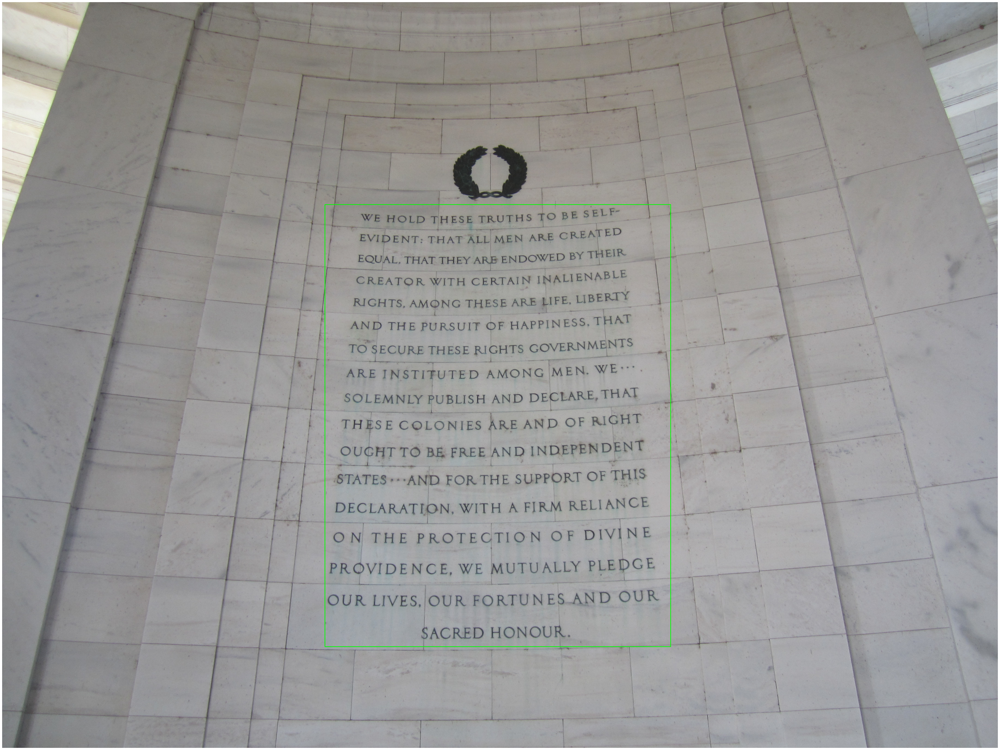

In [18]:
jimshow(ROI_image)

__Crop image to ROI__

In [19]:
image_cropped = cv2.bitwise_and(image, image, mask=mask)

NameError: name 'mask' is not defined

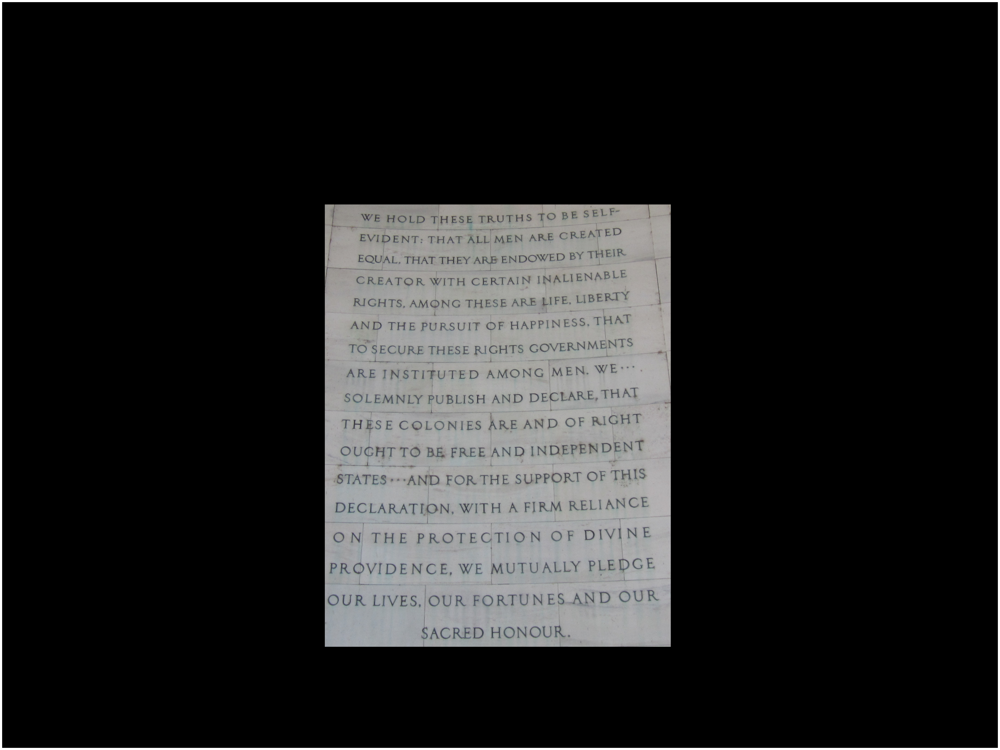

In [160]:
jimshow(image_cropped)

In [161]:
cv2.imwrite("image_cropped.jpg", image_cropped)

True

__Canny Edge Detection__

In [179]:
grey_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

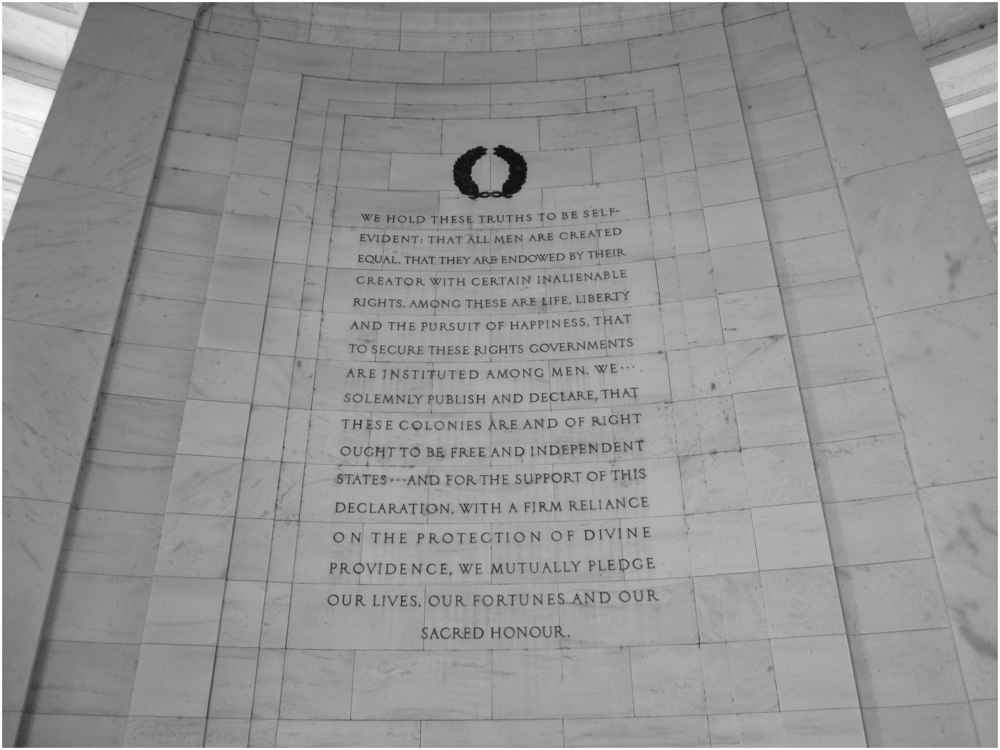

In [180]:
jimshow_channel(grey_image)

In [181]:
blurred_image = cv2.GaussianBlur(grey_image, (5,5), 0)

In [182]:
# Automatic thresholds
def auto_canny(image, sigma=0.33):
    v = np.median(image)
    
    lower = int(max(0, (1.0 - sigma) * v))
    upper = int(min(255, (1.0 + sigma) * v))
    edged = cv2.Canny(image, lower, upper)
    
    return edged

In [183]:
canny = auto_canny(blurred_image)

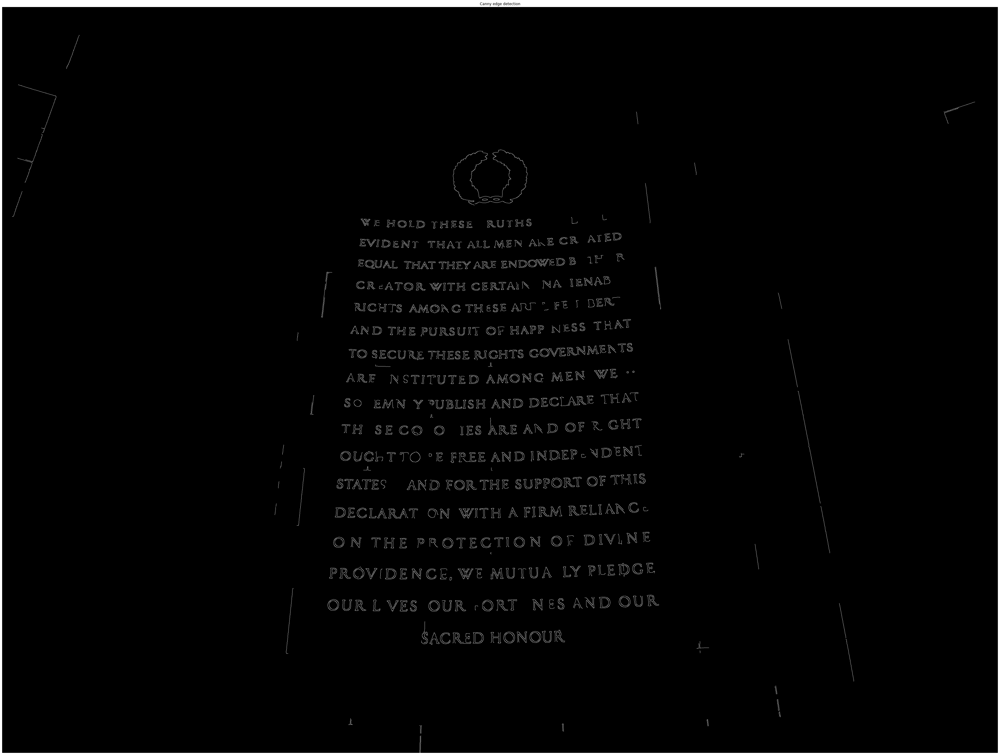

In [184]:
jimshow_channel(canny, "Canny edge detection")

__Contours__

In [185]:
(contours, _) = cv2.findContours(canny.copy(),
                 cv2.RETR_EXTERNAL,
                 cv2.CHAIN_APPROX_SIMPLE)

In [169]:
contours

[array([[[1403,  879]],
 
        [[1402,  880]],
 
        [[1400,  880]],
 
        ...,
 
        [[1413,  879]],
 
        [[1412,  880]],
 
        [[1404,  880]]], dtype=int32)]

In [186]:
image_letters = cv2.drawContours(image_cropped.copy(),
                        contours,
                        -1,
                        (0,255,0),
                        2)

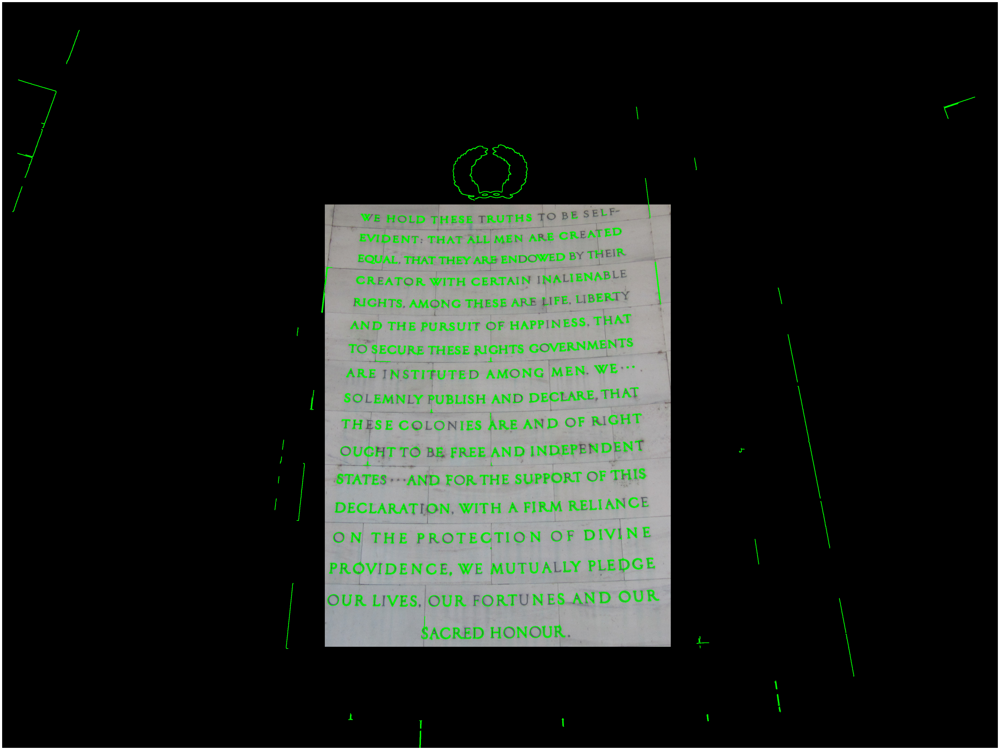

In [187]:
jimshow(image_letters)

In [172]:
cv2.imwrite("image_letters.jpg", image_letters)

True